# Exercizes on clustering

Here you can find a program to read a data file in csv format. 
The data file has the following heading:
    number of samples, number of features
    list of the names of the features (separated by comma)
The remaining lines contain an example per row.
For each row there is a list of real numbers (commas separated) which are the feature values.   

## Notes
all the three datasets contain data points on (x,y) 

In [15]:
import csv
import sys
import numpy as np
from os.path import join
from kneed import KneeLocator
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans, DBSCAN
from sklearn.metrics import silhouette_score
from sklearn.neighbors import NearestNeighbors


# this function reads the data file, loads the configuration attributes specifiefd in the heading
# (numer of examples and features), the list of feature names
# and loads the data in a matrix named data    
def load_data(file_path, file_name):
   with open(join(file_path, file_name)) as csv_file:
       data_file = csv.reader(csv_file,delimiter=',')
       temp1 = next(data_file)
       n_samples = int(temp1[0])
       print("n_samples=")
       print(n_samples)
       n_features = int(temp1[1])
       temp2 = next(data_file)
       feature_names = np.array(temp2[:n_features])

       data_list = [iter for iter in data_file]
               
       data = np.asarray(data_list, dtype=np.float64)                  
       
   return(data,feature_names,n_samples,n_features)

def run_kmeans(r_seed, cluster_no, data):
    np.random.seed(r_seed)
    return KMeans(n_clusters=cluster_no, random_state=451).fit(data)

def run_dbscan(eps, min_neighbourhood, data):
    return DBSCAN(eps=eps, min_samples=min_neighbourhood).fit(data)

def calc_silhouette(data, predicted):
    return silhouette_score(data, predicted, metric='euclidean')

def trace_kmeans(data, title):
    matstr = ""
    for i in range(10):
        kmeans = run_kmeans(3, i+2, data)
        matstr += "{} {}; ".format(calc_silhouette(data, kmeans.labels_), 10-(i+2))

    plot_data(np.array(np.mat(matstr[:-2])), title, "line")

def trace_dbscan(data, title):
    matstr = ""
    for i in range(10):
        dbscan = run_dbscan(0.5, i+2, data)
        matstr += "{} {}; ".format(calc_silhouette(data, dbscan.labels_), 10-(i+2))

    plot_data(np.array(np.mat(matstr[:-2])), title, "line")

def get_knee(data, n_neigh=5):
    nearest_neighbors = NearestNeighbors(n_neighbors=n_neigh)
    neighbors = nearest_neighbors.fit(data)
    distances, indices = neighbors.kneighbors(data)
    distances = np.sort(distances[:,n_neigh-1], axis=0)

    i = np.arange(len(distances))
    knee = KneeLocator(i, distances, S=1, curve='convex', direction='increasing', interp_method='polynomial')
    fig = plt.figure(figsize=(8, 8))
    knee.plot_knee()
    plt.xlabel("Points")
    plt.ylabel("Distance")

    return distances[knee.knee]

def plot_data(data, title, mode='dot'):
    fig = plt.figure(figsize=(8,8))

    ax = fig.add_subplot(111)
    fig.subplots_adjust(top=1)
    ax.set_title(title)

    ax.set_xlabel(feature_names1[0])
    ax.set_ylabel(feature_names1[1])

    #plot the dataset
    if mode == 'dot':
        plt.plot(data[:,0], data[:,1], '.',markersize=1)
    elif mode == 'line':
        plt.plot(data[:,0], data[:,1], markersize=1)
    else:
        plt.plot(data[:,0], data[:,1], '.',markersize=1)

    plt.show()

def plot_score(data, title):
    fig = plt.figure(figsize=(8,8))

    ax = fig.add_subplot(111)
    fig.subplots_adjust(top=1)
    ax.set_title(title)

    ax.set_xlabel(feature_names1[0])
    ax.set_ylabel(feature_names1[1])

    #plot the dataset
    plt.plot(data[:,0], data[:,1], '.' ,markersize=1)

    plt.show()

def plot_clusters(data, clusterizer, title):
    fig = plt.figure(figsize=(8,8))

    ax = fig.add_subplot(111)
    fig.subplots_adjust(top=1)
    ax.set_title(title)

    ax.set_xlabel('x')
    ax.set_ylabel('y')

    # set the list of colors to be selected when plotting the different clusters
    color=['b','g','r','c','m','y','w', 'k']
        
    #plot the dataset
    for clu in range(-1, len(color)):
        # collect the sequence of cooordinates of the points in each given cluster (determined by clu)
        data_list_x = [data[i,0] for i in range(data.shape[0]) if clusterizer.labels_[i]==clu]
        data_list_y = [data[i,1] for i in range(data.shape[0]) if clusterizer.labels_[i]==clu]
        plt.scatter(data_list_x, data_list_y, s=2, edgecolors='none', c=color[clu], alpha=0.95)

    plt.show()

# The main program reads the input file containing the dataset
# file_path is the file path where the file with the data to be read are located
# we assume the file contains an example per line
# each example is a list of real values separated by a comma (csv format)
# The first line of the file contains the heading with:
# N_samples,n_features,
# The second line contains the feature names separated by a comma     

#file_path="content/"
file_path="../datasets"
# all the three datasets contain data points on (x,y) 
file_name1="3-clusters.csv"
file_name2="dataset-DBSCAN.csv"     
file_name3="CURE-complete.csv"    
data1,feature_names1,n_samples1,n_features1 = load_data(file_path, file_name1)
data2,feature_names2,n_samples2,n_features2 = load_data(file_path, file_name2)
data3,feature_names3,n_samples3,n_features3 = load_data(file_path, file_name3)
print("dataset n. 1: n samples, n features")
print(n_samples1, n_features1)
print("dataset n. 2: n samples, n features")
print(n_samples2, n_features2)
print("dataset n. 3: n samples, n features")
print(n_samples3, n_features3)

n_samples=
150
n_samples=
6118
n_samples=
86558
dataset n. 1: n samples, n features
150 2
dataset n. 2: n samples, n features
6118 2
dataset n. 3: n samples, n features
86558 2


The following program plots the dataset n.1

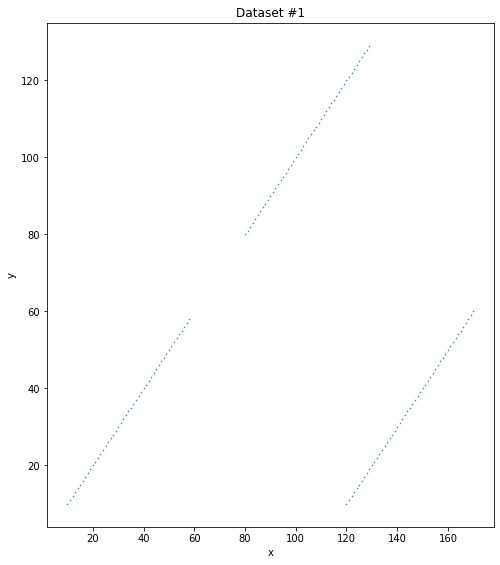

In [3]:
plot_data(data1, "Dataset #1")

The following is the program for plotting the dataset n.2

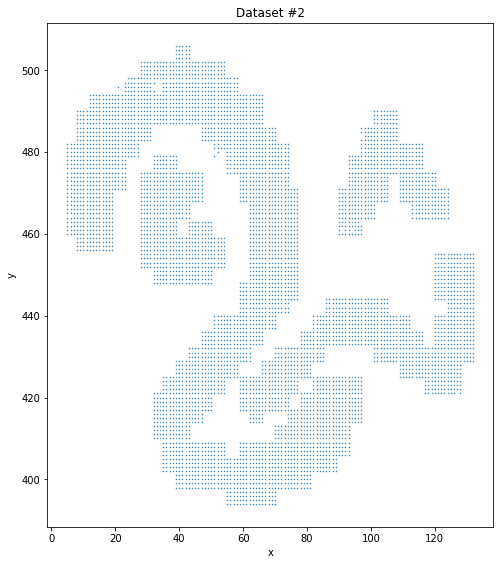

In [4]:
plot_data(data2, "Dataset #2")

The following is the program for plotting the dataset n.3

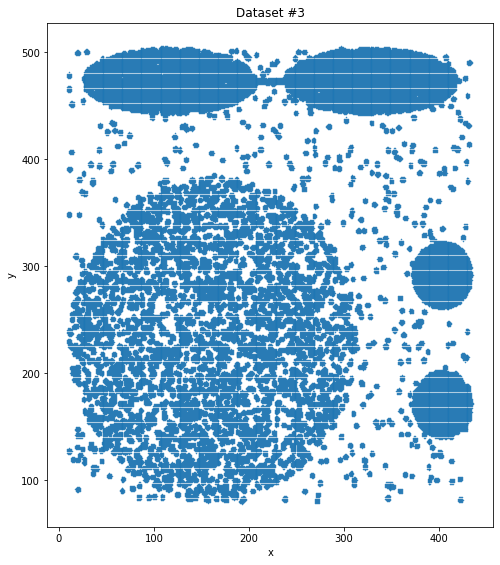

In [5]:
plot_data(data3, "Dataset #3")

## In the following program we cluster the dataset n.1 with K-means. 
From the plot of dataset n.1 we see 3 separated clusters. Thus k=3. 

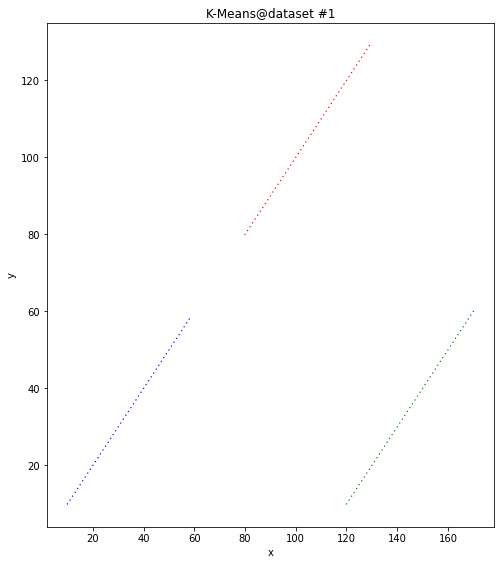

In [6]:
kmeans = run_kmeans(5, 3, data1)
plot_clusters(data1, kmeans, "K-Means@dataset #1")

In [7]:
silhouette_score(data1, kmeans.labels_, metric='euclidean')

0.7229402453727759

Perform clustering with K-means on dataset2 then, plot clustering results on dataset2.

**Answer:** 
how do you explain what it happens?

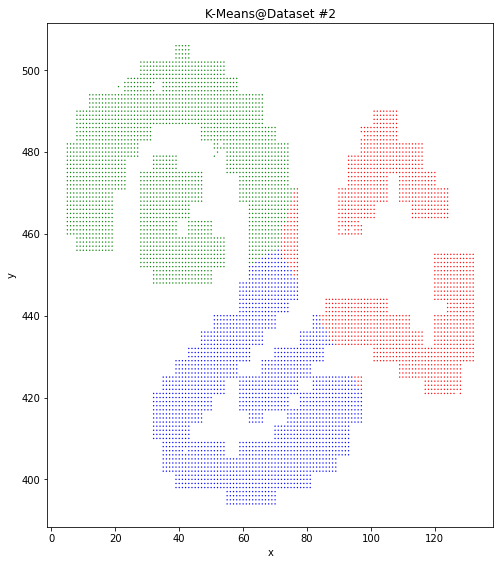

In [8]:
kmeans = run_kmeans(5, 3, data2)
plot_clusters(data2, kmeans, "K-Means@Dataset #2")

Perform clustering with K-means on the dataset3 then, plot clustering results on dataset3.

**Answer:** 
how do you explain what it happens?

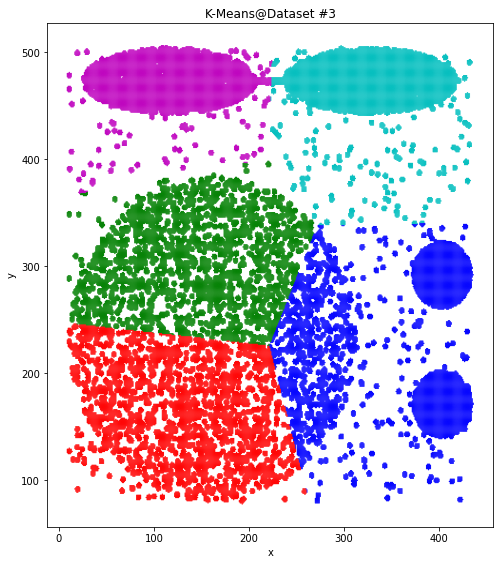

In [9]:
kmeans = run_kmeans(5, 5, data3)
plot_clusters(data3, kmeans, "K-Means@Dataset #3")

In the following cells I propose you to write a program that computes with a statistical measure of your choice a quantitative evaluation of clusters in the three datasets.

**Note:**
It is advisable to execute K-means a certain number of times (let us try 10 times) and then select the clustering solution that gives the best value of the evaluation measure.

In [119]:
kmeans = run_kmeans(3, 3, data1)
calc_silhouette(data1, kmeans.labels_)

0.7229402453727759

As already done with classification by k-nn, plot in the cell below the quantitative measure of your choice (used above) with respect to an increasing value of k (the number of clusters) so that the best value of k can be selected.

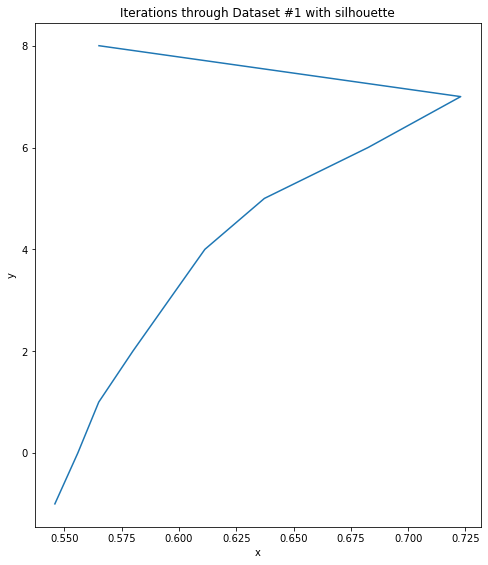

In [15]:
trace_kmeans(data1, "Iterations through Dataset #1 with silhouette")

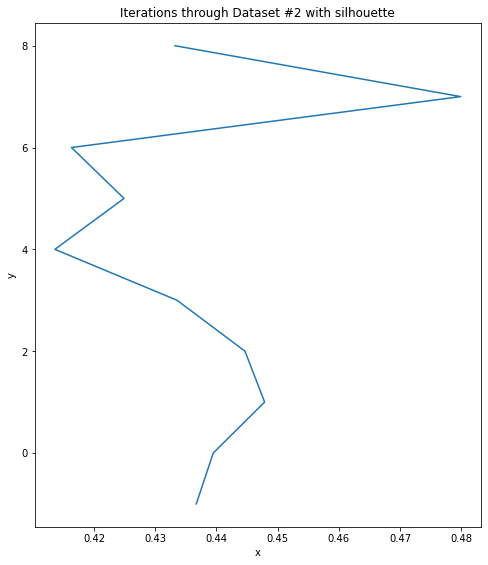

In [16]:
trace_kmeans(data2, "Iterations through Dataset #2 with silhouette")

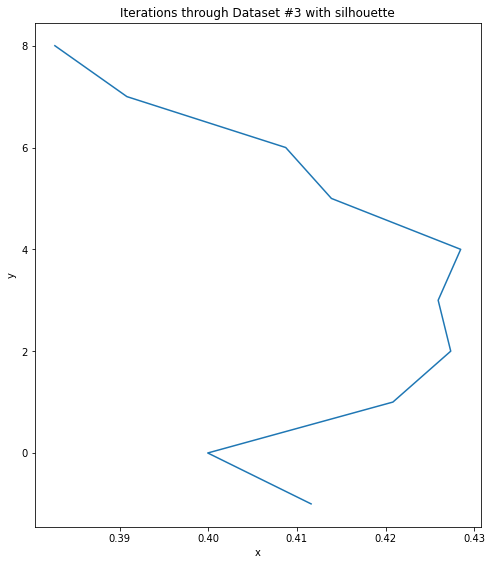

In [17]:
trace_kmeans(data3, "Iterations through Dataset #3 with silhouette")

In the following cell I propose you to run DBSCAN, instead, on one of the last two datasets: either dataset2 or dataset3. 

At the beginning try using a pair of Minpts and Eps of your choice.

**Note:**
If the data is too big, **sample it random, using a factor of 0.1.**

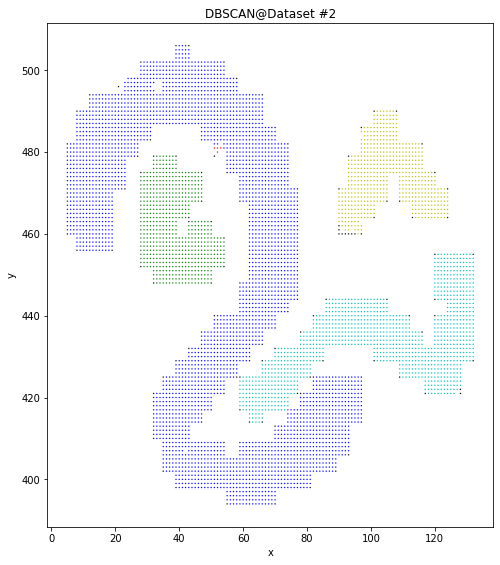

In [186]:
dbscan = run_dbscan(1, 5, data2)
plot_clusters(data2, dbscan, "DBSCAN@Dataset #2")

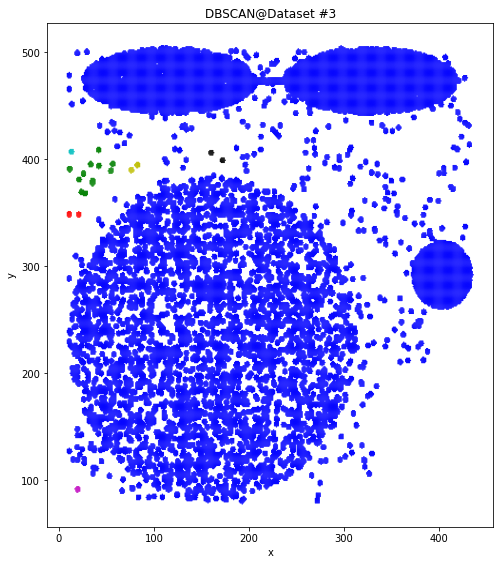

In [18]:
dbscan = run_dbscan(10, 3, data3)
plot_clusters(data3, dbscan, "DBSCAN@Dataset #3")

In the following cell I propose you to: 

1.   Set *Minpts* to a number (say **10**).
2.   Compute the **reachability distance** of the **10-th nearest neighbour ** for each data-point.
3. Sort the set of reachability distances you obtained in an increasing way.
4. Plot the sorted reachability distances
5. Find the **elbow** of the diagram => it gives the eps value combined with Minpts=10.
6. Try this combined pair of parameters on the dataset you chose, with DBSCAN.

EPS: 2.23606797749979


<Figure size 576x576 with 0 Axes>

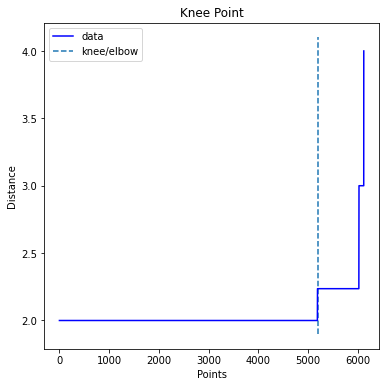

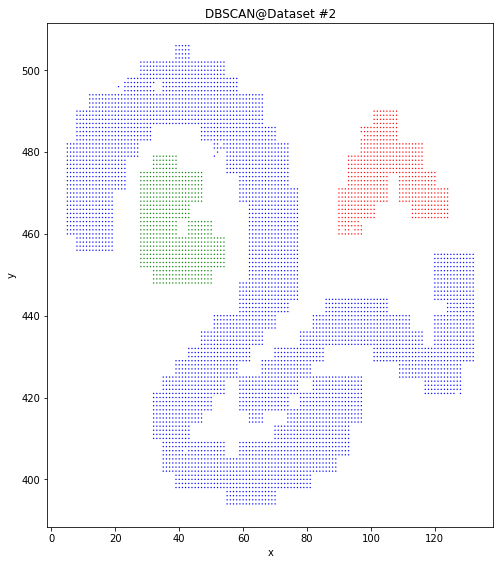

In [17]:
min_neigh = 10
knee = get_knee(data2, min_neigh)
print("EPS: {}".format(knee))
dbscan = run_dbscan(knee, min_neigh, data2)
plot_clusters(data2, dbscan, "DBSCAN@Dataset #2")
